<a href="https://colab.research.google.com/github/reshalfahsi/movie-review-sentiment-analysis/blob/master/Movie_Review_Sentiment_Analysis_Using_CNN_and_MLP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Movie Review Sentiment Analysis Using CNN and MLP**

## **Prerequisite**

In [ ]:
!wget https://ai.stanford.edu/~amaas/data/sentiment/aclImdb_v1.tar.gz
!tar -xzf "/content/aclImdb_v1.tar.gz"
!rm -rf /content/aclImdb_v1.tar.gz
!rm -rf /content/aclImdb/train/unsup

--2023-06-18 05:17:46--  https://ai.stanford.edu/~amaas/data/sentiment/aclImdb_v1.tar.gz
Resolving ai.stanford.edu (ai.stanford.edu)... 171.64.68.10
Connecting to ai.stanford.edu (ai.stanford.edu)|171.64.68.10|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 84125825 (80M) [application/x-gzip]
Saving to: ‘aclImdb_v1.tar.gz’

aclImdb_v1.tar.gz   100%[===================>]  80.23M  63.7MB/s    in 1.3s    

2023-06-18 05:17:47 (63.7 MB/s) - ‘aclImdb_v1.tar.gz’ saved [84125825/84125825]



In [ ]:
!pip install -q --no-cache-dir torchtext lightning torchmetrics pdf2image
!apt install -qq -y texlive-latex-recommended texlive-latex-extra dvipng
!apt install -qq -y texlive-fonts-recommended latex-cjk-all poppler-utils
!apt update -qq -y
!apt upgrade -qq -y

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 51.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 519.2/519.2 kB 390.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.4/66.4 kB 292.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.7/69.7 kB 215.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.5/55.5 kB 270.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 562.4/562.4 kB 376.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.7/45.7 kB 276.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 68.9/68.9 kB 299.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 kB 289.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.9/129.9 kB 305.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 720.6/720.6 kB 375.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.3/64.3 kB 319.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━

## **Important Libraries**

In [ ]:
import os
import re
import io
import cv2
import random
import string
import subprocess
import numpy as np
import matplotlib.pyplot as plt
from pdf2image import convert_from_path
from scipy.ndimage import interpolation

from google.colab.patches import cv2_imshow

import torch
import torch.nn as nn
import torch.optim as optim
import torch.utils.data as data
import torch.nn.functional as F
from torchtext.data import get_tokenizer
from torchtext.vocab import build_vocab_from_iterator

import lightning as L
from lightning.pytorch import Trainer, seed_everything
from lightning.pytorch.loggers import TensorBoardLogger, CSVLogger
from lightning.pytorch.callbacks.early_stopping import EarlyStopping
from lightning.pytorch.callbacks import LearningRateMonitor, ModelCheckpoint

from torchmetrics.classification import Accuracy

%matplotlib inline
plt.rcParams['axes.facecolor'] = 'lightgray'

## **Dataset**

In [ ]:
DATASET_PATH = "/content/aclImdb"
VOCAB_PATH = "/content/aclImdb/imdb.vocab"

In [ ]:
class IMDBDataset(data.Dataset):
    def __init__(
        self,
        dataset_path,
        vocab_path,
        max_sequence=200,
        val_ratio=0.1,
        inference=False,
    ):
        super().__init__()

        def yield_tokens(file_path):
            with io.open(file_path, encoding="utf-8") as f:
                for line in f:
                    yield line.strip().split()

        self.vocab = build_vocab_from_iterator(
            yield_tokens(vocab_path), specials=["<unk>"]
        )
        self.vocab.set_default_index(self.vocab['<unk>'])

        self.tokenizer = get_tokenizer("basic_english")

        self.max_sequence = max_sequence

        if not inference:
            neg_train_ds = os.listdir(os.path.join(dataset_path, "train/neg"))
            pos_train_ds = os.listdir(os.path.join(dataset_path, "train/pos"))
            train_ds = list()
            for neg, pos in zip(neg_train_ds, pos_train_ds):
                train_ds.append(
                    (os.path.join(os.path.join(dataset_path, "train/neg"), neg), 0)
                )
                train_ds.append(
                    (os.path.join(os.path.join(dataset_path, "train/pos"), pos), 1)
                )
            random.shuffle(train_ds)
            index_split = int(len(train_ds) * val_ratio)
            self.val_ds = train_ds[-index_split:]
            self.train_ds = train_ds[:-index_split]

            neg_test_ds = os.listdir(os.path.join(dataset_path, "test/neg"))
            pos_test_ds = os.listdir(os.path.join(dataset_path, "test/pos"))
            self.test_ds = list()
            for neg, pos in zip(neg_test_ds, pos_test_ds):
                self.test_ds.append(
                    (os.path.join(os.path.join(dataset_path, "test/neg"), neg), 0)
                )
                self.test_ds.append(
                    (os.path.join(os.path.join(dataset_path, "test/pos"), pos), 1)
                )
        else:
            self.__split = "inference"
            self.inference_ds = [[dataset_path]]

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        ds = self.dataset[idx]
        txt = ""
        with open(ds[0]) as f:
            txt = re.sub(
                f"[{re.escape(string.punctuation)}]",
                "",
                f.read().lower().replace("<br />", " "),
            )
        txt = self.tokenizer(txt)
        if len(txt) > self.max_sequence:
            txt = txt[:self.max_sequence]
        else:
            seq_length_diff = self.max_sequence - len(txt)
            for _ in range(seq_length_diff): txt.append("")
        txt = torch.tensor(self.vocab(txt), dtype=torch.long)

        if self.__split != "inference":
            score = torch.Tensor([ds[1]]).to(torch.int64).squeeze()
            return txt, score
        else:
            return txt

    @classmethod
    def inference_dataset(cls, data_pth, vocab_pth):
        return cls(data_pth, vocab_pth, inference=True)

    def split(self, __split):
        self.__split = __split
        return self

    @property
    def dataset(self):
        assert self.__split is not None, "Please specify the split of dataset!"

        if self.__split == "train":
            return self.train_ds
        elif self.__split == "val":
            return self.val_ds
        elif self.__split == "test":
            return self.test_ds
        elif self.__split == "inference":
            return self.inference_ds
        else:
            raise TypeError("Unknown type of split!")

In [ ]:
imdb_dataset = IMDBDataset(DATASET_PATH, VOCAB_PATH)

## **Model**

### **Visualize**

In [ ]:
class CAMExtractor(object):
    """
        Extracts CAM features from the model
    """
    def __init__(self, model):
        self.model = model
        self.gradients = list()

    def save_gradient(self, grad):
        self.gradients.append(grad)

    def forward_pass_on_convolutions(self, x):
        """
            Does a forward pass on convolutions, hooks the function at given layer
        """
        conv_output = list()
        for module_pos, module in self.model.conv._modules.items():
            x = module(x)
            if int(module_pos) % 3 == 0:
                x.register_hook(self.save_gradient)
                conv_output.append(x)
        return conv_output, x

    def forward_pass(self, x):
        """
            Does a full forward pass on the model
        """
        x = self.model.embedding(x)
        x = x.permute(0,2,1)
        conv_output, x = self.forward_pass_on_convolutions(x)
        x = x.mean(axis=-1)
        x = self.model.mlp(x)
        return conv_output, x


class GradCAM(object):
    """
        Produces class activation map
    """
    def __init__(self, model):
        self.model = model
        self.model.eval()
        self.extractor = CAMExtractor(self.model)

    def generate_cam(self, x, target=None):
        # Full forward pass
        # conv_output is the output of convolutions at specified layer
        # model_output is the final output of the model (1, 1000)

        conv_output, model_output = self.extractor.forward_pass(x)

        if target is None:
            target = np.argmax(model_output.data.numpy())

        # Target for backprop
        one_hot_output = torch.FloatTensor(1, model_output.size()[-1]).zero_()
        one_hot_output[0][target] = 1

        # Zero grads
        self.model.embedding.zero_grad()
        self.model.conv.zero_grad()
        self.model.mlp.zero_grad()

        # Backward pass with specified target
        model_output.backward(gradient=one_hot_output, retain_graph=True)

        # Get hooked gradients
        guided_gradients = [grad.data.numpy() for grad in self.extractor.gradients]

        # Get convolution outputs
        target = [out.data.numpy() for out in conv_output]

        # Get weights from gradients
        # Take averages for each gradient
        weights = [np.mean(grad, axis=(0, 2)) for grad in guided_gradients][::-1]

        # Create empty numpy array for cam
        cam = [np.zeros(t.shape[1:], dtype=np.float32) for t in target]

        # Multiply each weight with its conv output and then, sum
        for c, t, w in zip(cam, target, weights):
            # print(c.shape, t.shape, w.shape)
            for idx in range(t.shape[1]):
                c += t[:, idx, :] * w[idx]

        heatmap = [np.mean(c, axis=0).squeeze() for c in cam]
        heatmap = [np.maximum(h, 0) for h in heatmap]
        heatmap = [h/np.max(h) for h in heatmap]

        return heatmap

In [ ]:
latex_special_token = ["!@#$%^&*()"]


def generate(text_list, attention_list, latex_file, color="red", rescale_value=False):
    assert len(text_list) == len(attention_list)
    if rescale_value:
        attention_list = rescale(attention_list)
    word_num = len(text_list)
    text_list = clean_word(text_list)
    with open(latex_file, "w") as f:
        f.write(
            r"""\documentclass[varwidth]{standalone}
\special{papersize=210mm,297mm}
\usepackage{color}
\usepackage{tcolorbox}
\usepackage{CJK}
\usepackage{adjustbox}
\tcbset{width=0.9\textwidth,boxrule=0pt,colback=red,arc=0pt,auto outer arc,left=0pt,right=0pt,boxsep=5pt}
\begin{document}
\begin{CJK*}{UTF8}{gbsn}"""
            + "\n"
        )
        string = (
            r"""{\setlength{\fboxsep}{0pt}\colorbox{white!0}{\parbox{0.9\textwidth}{"""
            + "\n"
        )
        for idx in range(word_num):
            string += (
                "\\colorbox{%s!%s}{" % (color, int(attention_list[idx]))
                + "\\strut "
                + text_list[idx]
                + "} "
            )
        string += "\n}}}"
        f.write(string + "\n")
        f.write(
            r"""\end{CJK*}
\end{document}"""
        )


def rescale(input_list):
    the_array = np.asarray(input_list)
    the_max = np.max(the_array)
    the_min = np.min(the_array)
    rescale = (the_array - the_min) / (the_max - the_min) * 100
    return rescale.tolist()


def clean_word(word_list):
    new_word_list = []
    for word in word_list:
        for latex_sensitive in ["\\", "%", "&", "^", "#", "_", "{", "}"]:
            if latex_sensitive in word:
                word = word.replace(latex_sensitive, "\\" + latex_sensitive)
        new_word_list.append(word)
    return new_word_list

### **Utils**

In [ ]:
class AvgMeter(object):
    def __init__(self, num=40):
        self.num = num
        self.reset()

    def reset(self):
        self.losses = []

    def update(self, val):
        self.losses.append(val)

    def show(self):
        out = torch.mean(
            torch.stack(
                self.losses[np.maximum(len(self.losses)-self.num, 0):]
            )
        )
        return out

### **Wrapper**

In [ ]:
class ModelWrapper(L.LightningModule):
    def __init__(self, arch, dataset, batch_size, lr, max_epoch):
        super().__init__()

        self.arch = arch
        self.dataset = dataset
        self.batch_size = batch_size
        self.lr = lr
        self.max_epoch = max_epoch

        self.train_accuracy = Accuracy(task="multiclass", num_classes=2)
        self.val_accuracy = Accuracy(task="multiclass", num_classes=2)
        self.test_accuracy = Accuracy(task="multiclass", num_classes=2)

        self.automatic_optimization = False

        self.train_loss = []
        self.val_loss = []

        self.train_acc = []
        self.val_acc = []

        self.train_loss_recorder = AvgMeter()
        self.val_loss_recorder = AvgMeter()

        self.train_acc_recorder = AvgMeter()
        self.val_acc_recorder = AvgMeter()

    def forward(self, x):
        return self.arch(x)

    def training_step(self, batch, batch_nb):
        x, y = batch
        y_hat = self(x)
        loss = F.cross_entropy(y_hat, y)
        self.train_accuracy.update(y_hat, y)
        acc = self.train_accuracy.compute().data.cpu()

        opt = self.optimizers()
        opt.zero_grad()
        self.manual_backward(loss)
        opt.step()

        self.log("train_loss", loss, prog_bar=True)
        self.log("train_acc", acc, prog_bar=True)

        self.train_loss_recorder.update(loss.data)
        self.train_acc_recorder.update(acc)

    def on_train_epoch_end(self):
        sch = self.lr_schedulers()
        sch.step()

        self.train_loss.append(self.train_loss_recorder.show().data.cpu().numpy())
        self.train_loss_recorder = AvgMeter()

        self.train_acc.append(self.train_acc_recorder.show().data.cpu().numpy())
        self.train_acc_recorder = AvgMeter()

    def validation_step(self, batch, batch_nb):
        x, y = batch
        y_hat = self(x)
        loss = F.cross_entropy(y_hat, y)
        self.val_accuracy.update(y_hat, y)
        acc = self.val_accuracy.compute().data.cpu()

        self.log("val_loss", loss, prog_bar=True)
        self.log("val_acc", acc, prog_bar=True)

        self.val_loss_recorder.update(loss.data)
        self.val_acc_recorder.update(acc)

    def on_validation_epoch_end(self):
        self.val_loss.append(self.val_loss_recorder.show().data.cpu().numpy())
        self.val_loss_recorder = AvgMeter()

        self.val_acc.append(self.val_acc_recorder.show().data.cpu().numpy())
        self.val_acc_recorder = AvgMeter()

    def test_step(self, batch, batch_nb):
        x, y = batch
        y_hat = self(x)
        loss = F.cross_entropy(y_hat, y)
        self.test_accuracy.update(y_hat, y)

        self.log("test_loss", loss, prog_bar=True, logger=True)
        self.log(
            "test_acc", self.test_accuracy.compute(), prog_bar=True, logger=True
        )

    def on_train_end(self):

        # Loss
        loss_img_file = "/content/loss_plot.png"
        plt.plot(self.train_loss, color = 'r', label='train')
        plt.plot(self.val_loss, color = 'b', label='validation')
        plt.title("Loss Curves")
        plt.xlabel("Epoch")
        plt.ylabel("Loss")
        plt.legend()
        plt.grid()
        plt.savefig(loss_img_file)
        plt.clf()
        img = cv2.imread(loss_img_file)
        cv2_imshow(img)

        # Accuracy
        acc_img_file = "/content/acc_plot.png"
        plt.plot(self.train_acc, color = 'r', label='train')
        plt.plot(self.val_acc, color = 'b', label='validation')
        plt.title("Accuracy Curves")
        plt.xlabel("Epoch")
        plt.ylabel("Accuracy")
        plt.legend()
        plt.grid()
        plt.savefig(acc_img_file)
        plt.clf()
        img = cv2.imread(acc_img_file)
        cv2_imshow(img)

    def train_dataloader(self):
        return data.DataLoader(
            dataset=self.dataset.split("train"),
            batch_size=self.batch_size,
            shuffle=True,
        )

    def val_dataloader(self):
        return data.DataLoader(
            dataset=self.dataset.split("val"),
            batch_size=self.batch_size,
            shuffle=False,
        )

    def test_dataloader(self):
        return data.DataLoader(
            dataset=self.dataset.split("test"),
            batch_size=1,
            shuffle=False,
        )

    def configure_optimizers(self):

        optimizer = optim.Adam(
            self.parameters(),
            lr=self.lr,
        )
        lr_scheduler = {
            "scheduler": optim.lr_scheduler.MultiStepLR(
                optimizer,
                milestones=[int(self.max_epoch * 0.3), int(self.max_epoch * 0.8)],
                gamma=0.1
            ),
            "name": "lr_scheduler",
        }
        return [optimizer], [lr_scheduler]

### **Movie Review Sentiment Analysis Model**

In [ ]:
class MovieReviewSentimentAnalysisModel(nn.Module):
    def __init__(
        self,
        vocab_size,
        emb_dim=128,
    ):
        super().__init__()

        self.embedding = nn.Sequential(
            nn.Embedding(vocab_size, emb_dim),
            nn.Dropout(p=0.25),
        )

        self.conv = nn.Sequential(
            nn.Conv1d(emb_dim, emb_dim * 2, 11, padding=5),
            nn.BatchNorm1d(emb_dim * 2),
            nn.ReLU(True),
            nn.Conv1d(emb_dim * 2, emb_dim * 2, 11, padding=5),
            nn.BatchNorm1d(emb_dim * 2),
            nn.ReLU(True),
            nn.Conv1d(emb_dim * 2, emb_dim, 11, padding=5),
            nn.BatchNorm1d(emb_dim),
        )

        self.mlp = nn.Sequential(
            nn.Linear(emb_dim, emb_dim),
            nn.ReLU(True),
            nn.Dropout(p=0.25),
            nn.Linear(emb_dim, 2),
            nn.Softmax(),
        )

    def forward(self, x):
        x = self.embedding(x)
        x = x.permute(0,2,1)
        x = self.conv(x)
        x = x.mean(axis=-1)
        x = self.mlp(x)
        return x

In [ ]:
MODEL_NAME = "MovieReviewSentimentAnalysisModel"
model = MovieReviewSentimentAnalysisModel(len(imdb_dataset.vocab))

## **Training**

In [ ]:
MAX_EPOCH = 48
BATCH_SIZE = 32
LR = 1e-3
CHECKPOINT_DIR = os.getcwd()
SEED = int(np.random.randint(2147483647))

print(f"Random seed: {SEED}")

model = ModelWrapper(model, imdb_dataset, BATCH_SIZE, LR, MAX_EPOCH)

Random seed: 1941029236


In [ ]:
%reload_ext tensorboard
%tensorboard --logdir=logs/lightning_logs/

<IPython.core.display.Javascript object>

INFO: Global seed set to 1941029236
INFO:lightning.fabric.utilities.seed:Global seed set to 1941029236
INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/lightning/pytorch/callbacks/model_checkpoint.py:615: UserWarning: Checkpoint directory /content exists and is not empty.
  rank_zero_warn(f"Checkpoint directory {dirpath} exists and is not empty.")
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name           | 

Sanity Checking: 0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/container.py:217: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO: `Trainer.fit` stopped: `max_epochs=48` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=48` reached.


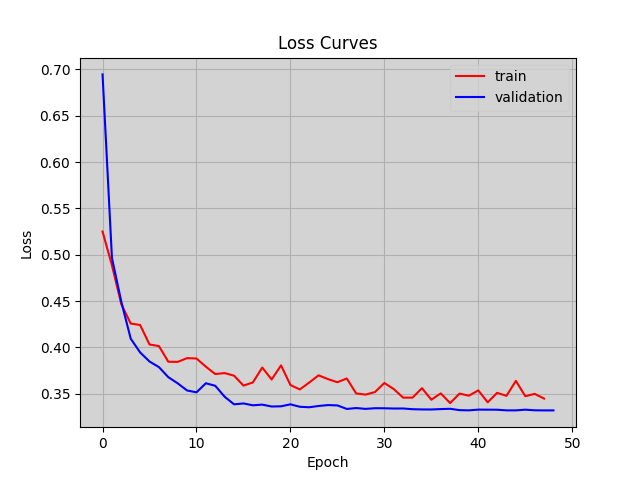

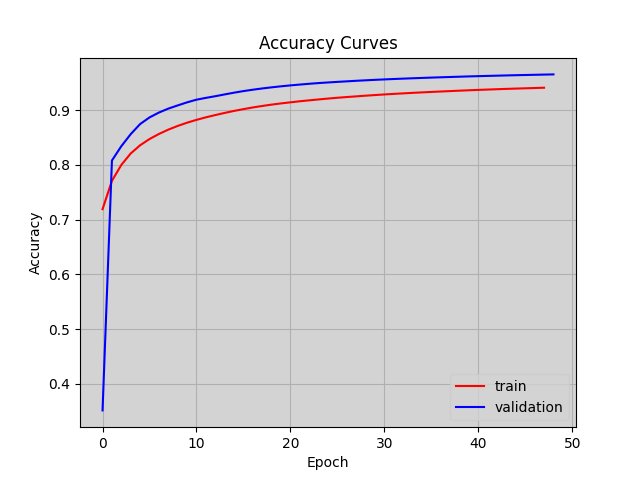

<Figure size 640x480 with 0 Axes>

In [ ]:
tensorboardlogger = TensorBoardLogger(save_dir="logs/")
csvlogger = CSVLogger(save_dir="logs/")
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint = ModelCheckpoint(
    monitor='val_acc',
    dirpath=CHECKPOINT_DIR,
    mode='max',
)
early_stopping = EarlyStopping(
    monitor="val_acc", min_delta=0.00, patience=3, verbose=False, mode="max"
)


seed_everything(SEED, workers=True)


trainer = Trainer(
    accelerator="auto",
    devices=1,
    max_epochs=MAX_EPOCH,
    logger=[tensorboardlogger, csvlogger],
    callbacks=[lr_monitor, checkpoint, early_stopping],
    log_every_n_steps=5,
)
trainer.fit(model)

## **Testing**

In [ ]:
trainer.test(ckpt_path="best")

INFO: Restoring states from the checkpoint path at /content/epoch=47-step=33792.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Restoring states from the checkpoint path at /content/epoch=47-step=33792.ckpt
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: Loaded model weights from the checkpoint at /content/epoch=47-step=33792.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Loaded model weights from the checkpoint at /content/epoch=47-step=33792.ckpt


Testing: 0it [00:00, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_acc          │    0.8561735153198242     │
│         test_loss         │    0.45390138030052185    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': 0.45390138030052185, 'test_acc': 0.8561735153198242}]

In [ ]:
os.rename(
    checkpoint.best_model_path,
    os.path.join(CHECKPOINT_DIR, f"{MODEL_NAME}_best.ckpt")
)

## **Inference**

### **Positive**

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: Restoring states from the checkpoint path at /content/MovieReviewSentimentAnalysisModel_best.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Restoring states from the checkpoint path at /content/MovieReviewSentimentAnalysisModel_best.ckpt
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: Loaded model weights from the checkpoint at /content/MovieReviewSentimentAnalysisModel_best.ckpt
INFO:lightning.pytorc

Predicting: 0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/container.py:217: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)
<ipython-input-30-253770db21c9>:49: DeprecationWarning: Please use `zoom` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  cam = interpolation.zoom(cam, txt_length/len(cam))






-----------------------------------------
Text length: 231
Terrific movie: If you did not watch yet, you must watch. Geena Davis and Samuel L. Jackson are amazing in this movie.

Great actors + good story + incredible action scenes > "The Long Kiss Goodnight" 

I give it a 10, A+, 4 stars.

--------Visualize CNN: Layer 0-------


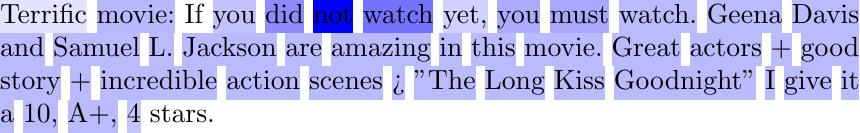


--------Visualize CNN: Layer 1-------


<ipython-input-30-253770db21c9>:49: DeprecationWarning: Please use `zoom` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  cam = interpolation.zoom(cam, txt_length/len(cam))


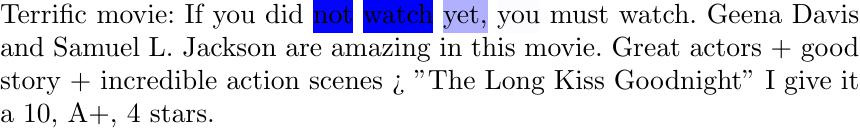


--------Visualize CNN: Layer 2-------


<ipython-input-30-253770db21c9>:49: DeprecationWarning: Please use `zoom` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  cam = interpolation.zoom(cam, txt_length/len(cam))


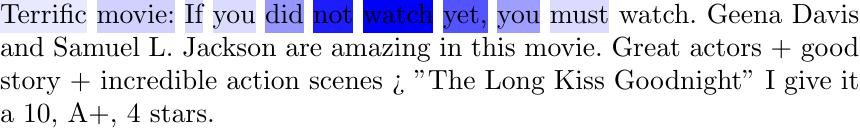

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs


-----------------------------------------
This review sentiment is positive with 100.0% confidence
-----------------------------------------
Ground-truth: Positive at /content/aclImdb/test/pos/2040_10.txt
-----------------------------------------





INFO: Restoring states from the checkpoint path at /content/MovieReviewSentimentAnalysisModel_best.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Restoring states from the checkpoint path at /content/MovieReviewSentimentAnalysisModel_best.ckpt
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: Loaded model weights from the checkpoint at /content/MovieReviewSentimentAnalysisModel_best.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Loaded model weights from the checkpoint at /content/MovieReviewSentimentAnalysisModel_best.ckpt


Predicting: 0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/container.py:217: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)






-----------------------------------------
Text length: 544
Mr Bean was great fun, i loved it, every episode was really funny, Rowan Atkinson was perfect for this role, he's a funny looking bloke and his facial expressions were hilarious!!! 

The series was so successful that they even made a Mr Bean movie in 1997, which was also pretty funny by the way!! 

It's funny seeing all the adventures and situations he gets himself into, this series was a classic for sure, and i still watch an episode from time to time.

Mr Bean is well worth a 10/10 in my book, fans of offbeat comedy must check this out.

--------Visualize CNN: Layer 0-------


<ipython-input-30-253770db21c9>:49: DeprecationWarning: Please use `zoom` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  cam = interpolation.zoom(cam, txt_length/len(cam))


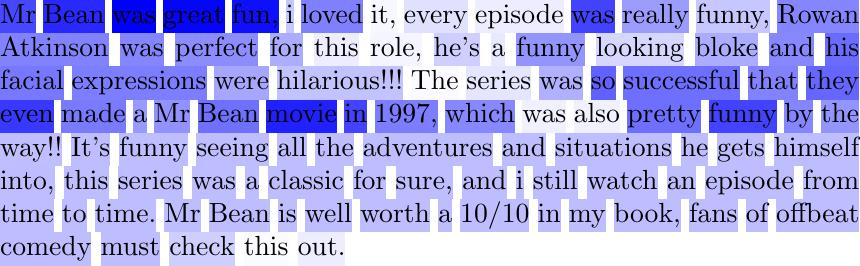


--------Visualize CNN: Layer 1-------


<ipython-input-30-253770db21c9>:49: DeprecationWarning: Please use `zoom` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  cam = interpolation.zoom(cam, txt_length/len(cam))


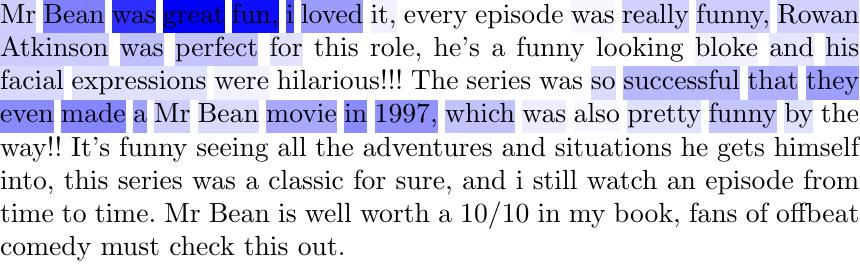


--------Visualize CNN: Layer 2-------


<ipython-input-30-253770db21c9>:49: DeprecationWarning: Please use `zoom` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  cam = interpolation.zoom(cam, txt_length/len(cam))


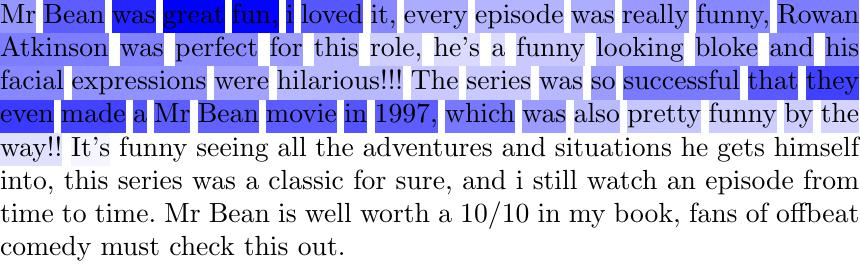

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs


-----------------------------------------
This review sentiment is positive with 100.0% confidence
-----------------------------------------
Ground-truth: Positive at /content/aclImdb/test/pos/1496_10.txt
-----------------------------------------





INFO: Restoring states from the checkpoint path at /content/MovieReviewSentimentAnalysisModel_best.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Restoring states from the checkpoint path at /content/MovieReviewSentimentAnalysisModel_best.ckpt
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: Loaded model weights from the checkpoint at /content/MovieReviewSentimentAnalysisModel_best.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Loaded model weights from the checkpoint at /content/MovieReviewSentimentAnalysisModel_best.ckpt


Predicting: 0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/container.py:217: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)






-----------------------------------------
Text length: 852
If you loved the 1993 (erotic, sci-fiction)cyborg film "Nemesis", then you'll love this one. I loved it the minute the Elvis Pompadoured hero pulls out a samurai sword during a shoot-out. Like "Nemesis" its takes place in a post apocalyptic slum of the future. Both are police thrillers where the well armed hero must take on well armed rebels, to solve a conspiracy by the powers that be against the unwashed masses. but thats where the similarities ends. The ambiguous mayor in dead or alive tries to keep the masses sedate on the drugs he sells them. The rebels aided by mercenaries and a cyborg, try to brake his suffocating hold on his subjects. After several failed attempts to brake the rebels back, he sends his top cop to assassinate the rebels. This movie follows the track of most action adventure but isn't afraid to color outside the line.

--------Visualize CNN: Layer 0-------


<ipython-input-30-253770db21c9>:49: DeprecationWarning: Please use `zoom` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  cam = interpolation.zoom(cam, txt_length/len(cam))


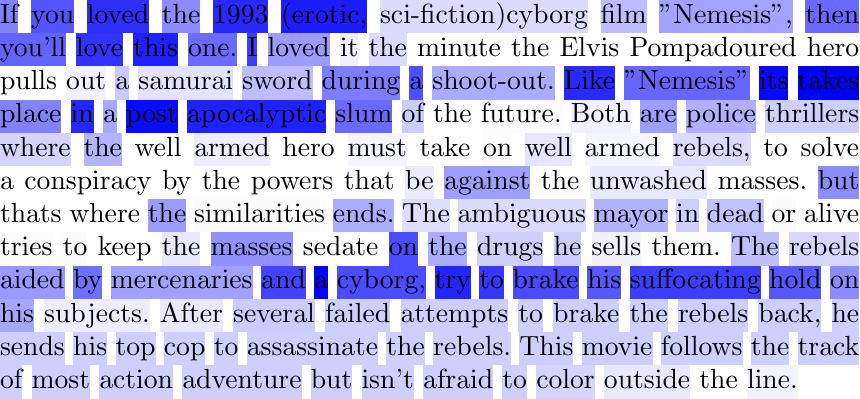


--------Visualize CNN: Layer 1-------


<ipython-input-30-253770db21c9>:49: DeprecationWarning: Please use `zoom` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  cam = interpolation.zoom(cam, txt_length/len(cam))


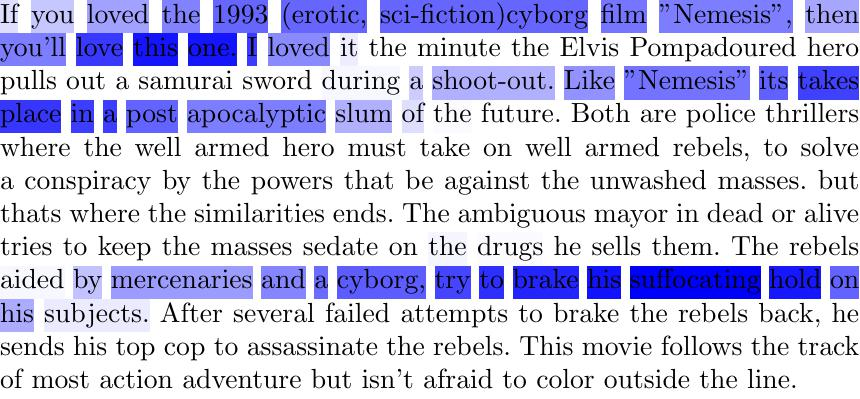


--------Visualize CNN: Layer 2-------


<ipython-input-30-253770db21c9>:49: DeprecationWarning: Please use `zoom` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  cam = interpolation.zoom(cam, txt_length/len(cam))


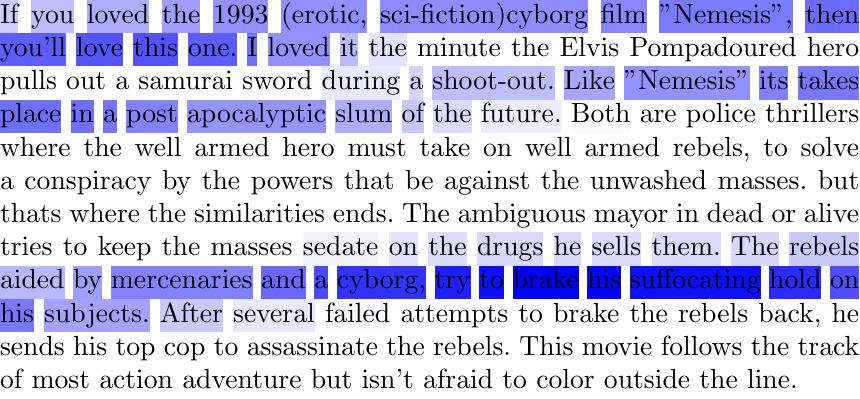

-----------------------------------------
This review sentiment is positive with 100.0% confidence
-----------------------------------------
Ground-truth: Positive at /content/aclImdb/test/pos/2371_10.txt
-----------------------------------------





In [ ]:
for sample in range(3):
    SAMPLE_DATA_PATH = "/content/aclImdb/test/pos"
    DATASET = os.listdir(SAMPLE_DATA_PATH)
    DATASET = DATASET[random.randint(0, len(DATASET) - 1)]
    SAMPLE_DATA_PATH = os.path.join(SAMPLE_DATA_PATH, DATASET)

    trainer = Trainer()
    prediction = trainer.predict(
        model=model,
        dataloaders=data.DataLoader(
            dataset=IMDBDataset.inference_dataset(SAMPLE_DATA_PATH, VOCAB_PATH),
            batch_size=1,
            shuffle=False,
        ),
        ckpt_path=os.path.join(CHECKPOINT_DIR, f"{MODEL_NAME}_best.ckpt"),
    )[0]

    print("\n\n\n")
    print("-----------------------------------------")
    with open(SAMPLE_DATA_PATH, "r") as f:
        TXT = f.read().replace("<br />", "\n")
        print(f"Text length: {len(TXT)}")
        print(TXT)

        txt = re.sub(
            f"[{re.escape(string.punctuation)}]",
            "",
            TXT.lower().replace("\n", " "),
        )
        txt = imdb_dataset.tokenizer(txt)
        if len(txt) > imdb_dataset.max_sequence:
            txt = txt[:imdb_dataset.max_sequence]
        else:
            seq_length_diff = imdb_dataset.max_sequence - len(txt)
            for _ in range(seq_length_diff): txt.append("")
        txt = torch.tensor(imdb_dataset.vocab(txt), dtype=torch.long).unsqueeze(0)
        txt.to("cuda" if torch.cuda.is_available() else "cpu")

        gradcam = GradCAM(trainer.strategy._lightning_module.arch)
        gradcam = gradcam.generate_cam(txt)

        TXT = TXT.split()
        txt_length = len(TXT)

        for idx, g in enumerate(gradcam):
            print(f"\n--------Visualize CNN: Layer {idx}-------")

            cam = np.array(g)
            cam = interpolation.zoom(cam, txt_length/len(cam))
            cam = np.nan_to_num(cam)
            cam = np.maximum(cam, 0)
            cam /= np.max(cam)
            cam = np.nan_to_num(cam)
            cam *= 100.
            cam = cam.tolist()

            tex_file = f"test_pos_{os.path.splitext(DATASET)[0]}_CNN{idx}.tex"
            generate(TXT, cam, tex_file, "blue")

            subprocess.run(
                f"pdflatex {tex_file}",
                shell=True,
                capture_output=True,
                check=True,
            )

            pages = convert_from_path(f"{os.path.splitext(tex_file)[0]}.pdf")
            output_jpg = f"{os.path.splitext(tex_file)[0]}.jpg"
            for i in range(len(pages)):
                pages[i].save(output_jpg, 'JPEG')

            img = cv2.imread(output_jpg)
            cv2_imshow(img)


    print("-----------------------------------------")

    SENTIMENT = "positive" if torch.argmax(prediction) == 1 else "negative"
    print(
        f"This review sentiment is {SENTIMENT} with {round(float(torch.max(prediction)), 4) * 100.}% confidence"
    )

    print("-----------------------------------------")
    print(f"Ground-truth: Positive at {SAMPLE_DATA_PATH}")
    print("-----------------------------------------\n\n\n")

### **Negative**

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: Restoring states from the checkpoint path at /content/MovieReviewSentimentAnalysisModel_best.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Restoring states from the checkpoint path at /content/MovieReviewSentimentAnalysisModel_best.ckpt
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: Loaded model weights from the checkpoint at /content/MovieReviewSentimentAnalysisModel_best.ckpt
INFO:lightning.pytorc

Predicting: 0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/container.py:217: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)
<ipython-input-22-f09be585a293>:49: DeprecationWarning: Please use `zoom` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  cam = interpolation.zoom(cam, txt_length/len(cam))






-----------------------------------------
Text length: 4263
First and foremost I'd like to state - for the record - that it's incredibly dumb to call your movie "Embryo" when the subject matter exclusively revolves on scientific research performed on fetuses (animal as well as human) aged 12-16 weeks. The embryonic stage is over at the end of the eighth pregnancy week and from that moment on the unborn critter enters the fetal phase. Okay, in all honestly, I didn't know all this, but I took the effort of looking it up and that's the also the least thing the creators of "Embryo" could have done. Don't worry; I'm not just stumbling over details or being exaggeratedly bitter, as there are several more reasons to state why "Embryo" is a huge failure. Actual science can be considered as boring and inaccessible, and thus Science Fiction is a cinematic genre created especially to make the otherwise tedious, yet educational science topics more interesting and comprehensible to larger audie

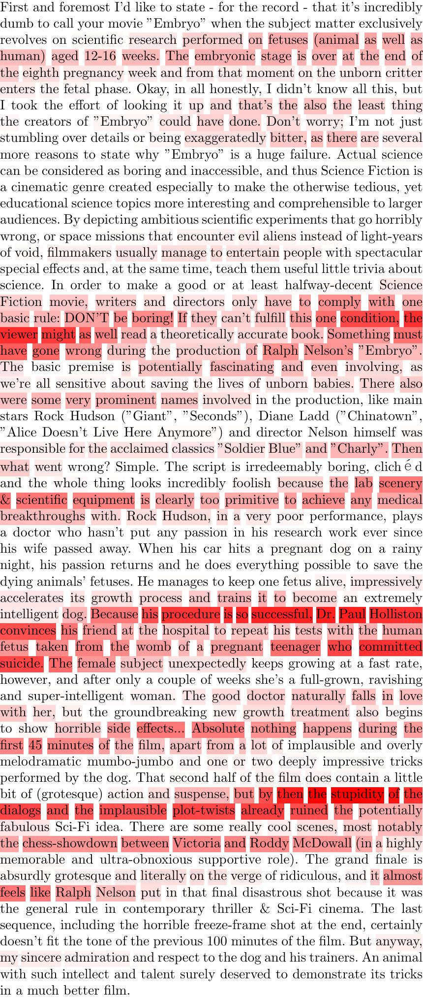


--------Visualize CNN: Layer 1-------


<ipython-input-22-f09be585a293>:49: DeprecationWarning: Please use `zoom` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  cam = interpolation.zoom(cam, txt_length/len(cam))


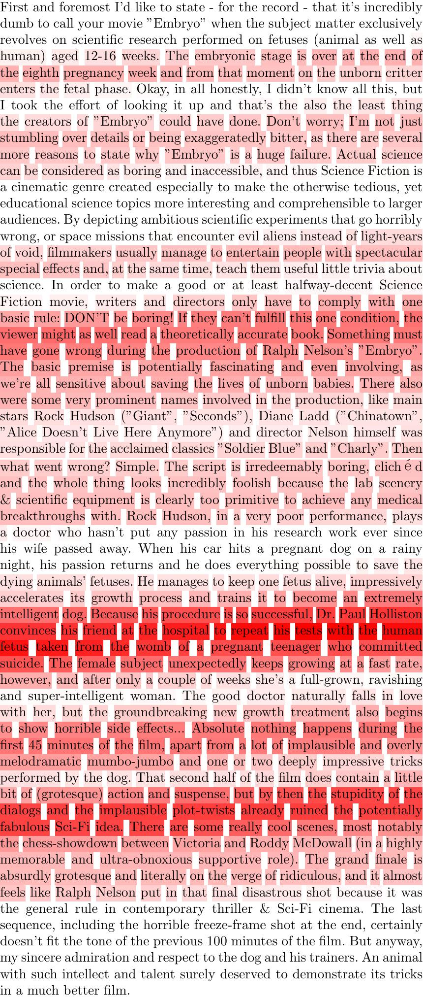


--------Visualize CNN: Layer 2-------


<ipython-input-22-f09be585a293>:49: DeprecationWarning: Please use `zoom` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  cam = interpolation.zoom(cam, txt_length/len(cam))


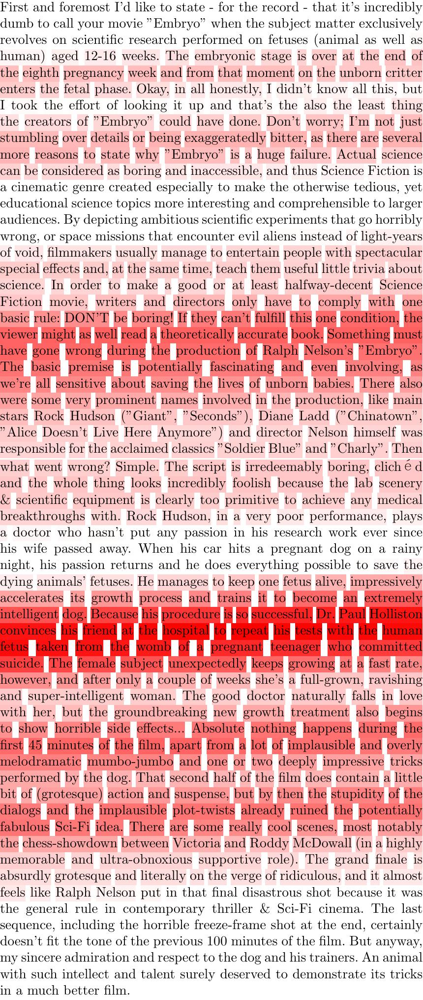

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs


-----------------------------------------
This review sentiment is negative with 100.0% confidence
-----------------------------------------
Ground-truth: Negative at /content/aclImdb/test/neg/8735_3.txt
-----------------------------------------





INFO: Restoring states from the checkpoint path at /content/MovieReviewSentimentAnalysisModel_best.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Restoring states from the checkpoint path at /content/MovieReviewSentimentAnalysisModel_best.ckpt
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: Loaded model weights from the checkpoint at /content/MovieReviewSentimentAnalysisModel_best.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Loaded model weights from the checkpoint at /content/MovieReviewSentimentAnalysisModel_best.ckpt


Predicting: 0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/container.py:217: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)






-----------------------------------------
Text length: 1042
This movie starts with interesting set design and a promising premise, but fails to provide the cult-movie goods. Set in a gritty parallel universe where everything is owned by the "Blump" Corporation, it concerns a horrible stand-up comic who finds success when he grows a third arm out of his back.

All the potential for great cheese is here -- washed-up 80's star Judd Nelson, Wayne Newton, offbeat visuals and strange plot digressions, obese women in skimpy lingerie, necrophilia -- but it never pays off.

The pacing is the main problem. Each scene is excrutiatingly slow. Nelson's stand-up routines are supposed to be funny because they're pathetically not funny. But each performance drags on until it's not even tangentially funny, just boring.

Imagine someone telling you the longest, weirdest joke imaginable, full of smirky self-congratulation for how funny and weird he thinks it is. Imagine after a stultifying two hours 

<ipython-input-22-f09be585a293>:49: DeprecationWarning: Please use `zoom` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  cam = interpolation.zoom(cam, txt_length/len(cam))


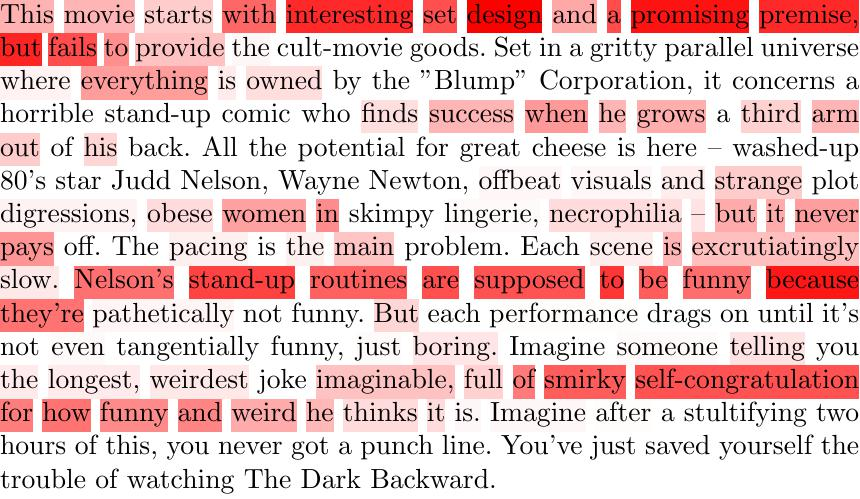


--------Visualize CNN: Layer 1-------


<ipython-input-22-f09be585a293>:49: DeprecationWarning: Please use `zoom` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  cam = interpolation.zoom(cam, txt_length/len(cam))


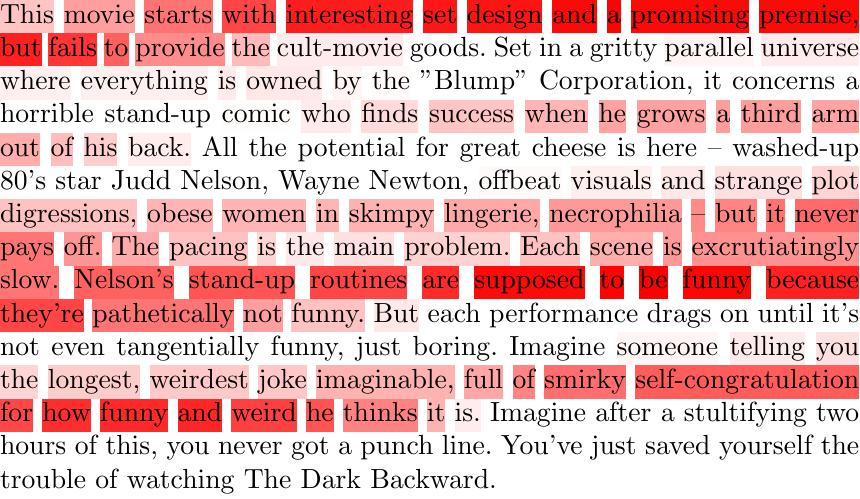


--------Visualize CNN: Layer 2-------


<ipython-input-22-f09be585a293>:49: DeprecationWarning: Please use `zoom` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  cam = interpolation.zoom(cam, txt_length/len(cam))


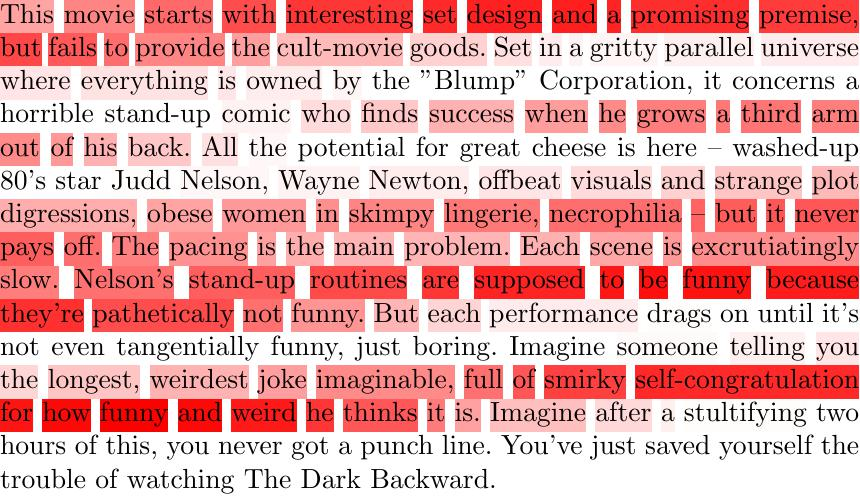

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs


-----------------------------------------
This review sentiment is negative with 100.0% confidence
-----------------------------------------
Ground-truth: Negative at /content/aclImdb/test/neg/7065_3.txt
-----------------------------------------





INFO: Restoring states from the checkpoint path at /content/MovieReviewSentimentAnalysisModel_best.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Restoring states from the checkpoint path at /content/MovieReviewSentimentAnalysisModel_best.ckpt
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: Loaded model weights from the checkpoint at /content/MovieReviewSentimentAnalysisModel_best.ckpt
INFO:lightning.pytorch.utilities.rank_zero:Loaded model weights from the checkpoint at /content/MovieReviewSentimentAnalysisModel_best.ckpt


Predicting: 0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/container.py:217: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)
<ipython-input-22-f09be585a293>:49: DeprecationWarning: Please use `zoom` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  cam = interpolation.zoom(cam, txt_length/len(cam))






-----------------------------------------
Text length: 360
What an embarassment...This doesnt do justice to the original with awful acting from everyone in this movie, Hitchcock must be spinning in his grave. The scence where Marion gets killed in the shower is just so uneffective and unoriginal. The only good bit is that they used the same music and its so obvious who kills her in the shower. I rate this movie 3/10

--------Visualize CNN: Layer 0-------


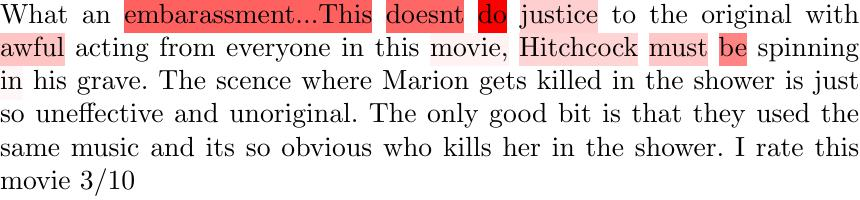


--------Visualize CNN: Layer 1-------


<ipython-input-22-f09be585a293>:49: DeprecationWarning: Please use `zoom` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  cam = interpolation.zoom(cam, txt_length/len(cam))


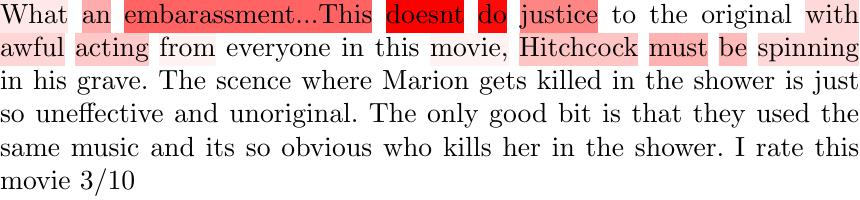


--------Visualize CNN: Layer 2-------


<ipython-input-22-f09be585a293>:49: DeprecationWarning: Please use `zoom` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  cam = interpolation.zoom(cam, txt_length/len(cam))


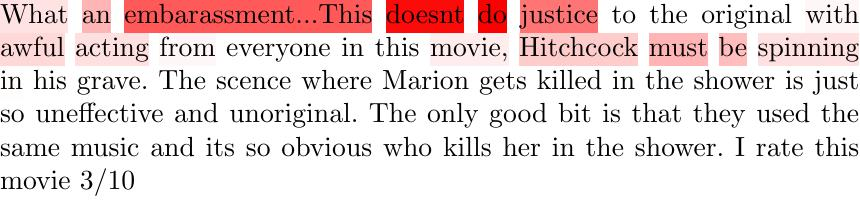

-----------------------------------------
This review sentiment is negative with 100.0% confidence
-----------------------------------------
Ground-truth: Negative at /content/aclImdb/test/neg/11741_3.txt
-----------------------------------------





In [ ]:
for sample in range(3):
    SAMPLE_DATA_PATH = "/content/aclImdb/test/neg"
    DATASET = os.listdir(SAMPLE_DATA_PATH)
    DATASET = DATASET[random.randint(0, len(DATASET) - 1)]
    SAMPLE_DATA_PATH = os.path.join(SAMPLE_DATA_PATH, DATASET)

    trainer = Trainer()
    prediction = trainer.predict(
        model=model,
        dataloaders=data.DataLoader(
            dataset=IMDBDataset.inference_dataset(SAMPLE_DATA_PATH, VOCAB_PATH),
            batch_size=1,
            shuffle=False,
        ),
        ckpt_path=os.path.join(CHECKPOINT_DIR, f"{MODEL_NAME}_best.ckpt"),
    )[0]

    print("\n\n\n")
    print("-----------------------------------------")
    with open(SAMPLE_DATA_PATH, "r") as f:
        TXT = f.read().replace("<br />", "\n")
        print(f"Text length: {len(TXT)}")
        print(TXT)

        txt = re.sub(
            f"[{re.escape(string.punctuation)}]",
            "",
            TXT.lower().replace("\n", " "),
        )
        txt = imdb_dataset.tokenizer(txt)
        if len(txt) > imdb_dataset.max_sequence:
            txt = txt[:imdb_dataset.max_sequence]
        else:
            seq_length_diff = imdb_dataset.max_sequence - len(txt)
            for _ in range(seq_length_diff): txt.append("")
        txt = torch.tensor(imdb_dataset.vocab(txt), dtype=torch.long).unsqueeze(0)
        txt.to("cuda" if torch.cuda.is_available() else "cpu")

        gradcam = GradCAM(trainer.strategy._lightning_module.arch)
        gradcam = gradcam.generate_cam(txt)

        TXT = TXT.split()
        txt_length = len(TXT)

        for idx, g in enumerate(gradcam):
            print(f"\n--------Visualize CNN: Layer {idx}-------")

            cam = np.array(g)
            cam = interpolation.zoom(cam, txt_length/len(cam))
            cam = np.nan_to_num(cam)
            cam = np.maximum(cam, 0)
            cam /= np.max(cam)
            cam = np.nan_to_num(cam)
            cam *= 100.
            cam = cam.tolist()

            tex_file = f"test_neg_{os.path.splitext(DATASET)[0]}_CNN{idx}.tex"
            generate(TXT, cam, tex_file, "red")

            subprocess.run(
                f"pdflatex {tex_file}",
                shell=True,
                capture_output=True,
                check=True,
            )

            pages = convert_from_path(f"{os.path.splitext(tex_file)[0]}.pdf")
            output_jpg = f"{os.path.splitext(tex_file)[0]}.jpg"
            for i in range(len(pages)):
                pages[i].save(output_jpg, 'JPEG')

            img = cv2.imread(output_jpg)
            cv2_imshow(img)

    print("-----------------------------------------")

    SENTIMENT = "positive" if torch.argmax(prediction) == 1 else "negative"
    print(
        f"This review sentiment is {SENTIMENT} with {round(float(torch.max(prediction)), 4) * 100.}% confidence"
    )

    print("-----------------------------------------")
    print(f"Ground-truth: Negative at {SAMPLE_DATA_PATH}")
    print("-----------------------------------------\n\n\n")

### **Finishing**

In [ ]:
# remove the annoying files
!rm -rf *.tex *.aux *.log *.pdf *.jpg *.png